<a href="https://colab.research.google.com/github/Mithil01/Visual-Question-Answering-System/blob/main/Visual_Question_Answering_final_version.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Making the Most of your Colab Subscription



In [ ]:
!unzip v2_Annotations_Train_mscoco.zip
!unzip v2_Questions_Train_mscoco.zip

Archive:  v2_Annotations_Train_mscoco.zip
  inflating: v2_mscoco_train2014_annotations.json  
Archive:  v2_Questions_Train_mscoco.zip
  inflating: v2_OpenEnded_mscoco_train2014_questions.json  


In [ ]:
!wget http://images.cocodataset.org/zips/train2014.zip

--2023-12-14 23:07:18--  http://images.cocodataset.org/zips/train2014.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 3.5.25.89, 52.217.136.9, 3.5.11.145, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|3.5.25.89|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13510573713 (13G) [application/zip]
Saving to: ‘train2014.zip’

train2014.zip       100%[===================>]  12.58G  41.6MB/s    in 5m 10s  

2023-12-14 23:12:28 (41.5 MB/s) - ‘train2014.zip’ saved [13510573713/13510573713]



In [ ]:
!unzip train2014.zip


Streaming output truncated to the last 5000 lines.
 extracting: train2014/COCO_train2014_000000408557.jpg  
 extracting: train2014/COCO_train2014_000000013714.jpg  
 extracting: train2014/COCO_train2014_000000194043.jpg  
 extracting: train2014/COCO_train2014_000000219859.jpg  
 extracting: train2014/COCO_train2014_000000278135.jpg  
 extracting: train2014/COCO_train2014_000000141015.jpg  
 extracting: train2014/COCO_train2014_000000280923.jpg  
 extracting: train2014/COCO_train2014_000000200024.jpg  
 extracting: train2014/COCO_train2014_000000435713.jpg  
 extracting: train2014/COCO_train2014_000000249993.jpg  
 extracting: train2014/COCO_train2014_000000424160.jpg  
 extracting: train2014/COCO_train2014_000000142761.jpg  
 extracting: train2014/COCO_train2014_000000532668.jpg  
 extracting: train2014/COCO_train2014_000000564904.jpg  
 extracting: train2014/COCO_train2014_000000346384.jpg  
 extracting: train2014/COCO_train2014_000000560934.jpg  
 extracting: train2014/COCO_train2014

In [ ]:
!pip install contractions

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 289.9/289.9 kB 5.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.8/110.8 kB 6.3 MB/s eta 0:00:00


In [ ]:
import json
import re
import nltk
import cv2
nltk.download('punkt')

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
from PIL import Image
from nltk.tokenize import word_tokenize
from collections import Counter
from wordcloud import WordCloud, STOPWORDS
import contractions

import datetime
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.preprocessing import image
from tensorflow.compat.v1.keras.layers import CuDNNLSTM
from tensorflow.keras.layers import (
    Embedding, LSTM, SpatialDropout1D, Input, concatenate, Dense,Add,Multiply,
    BatchNormalization, Dropout
)
from tensorflow.keras.callbacks import (
    LearningRateScheduler, ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
)
from tensorflow.keras.applications import resnet50
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input
from tensorflow.keras.utils import plot_model
from tensorflow.keras.utils import load_img

%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
questions = json.load(open('v2_OpenEnded_mscoco_train2014_questions.json', 'r'))
answers = json.load(open('v2_mscoco_train2014_annotations.json', 'r'))

In [ ]:
images = 'train2014'

print("Total number of images: ", len(os.listdir(images)))
print("Total number of questions: ", len(questions['questions']))
print("Total number of answer annotations: ", len(answers['annotations']))

Total number of images:  82783
Total number of questions:  443757
Total number of answer annotations:  443757


In [ ]:
print(questions.keys())
print(answers.keys())
print(questions['questions'][0])
print(answers['annotations'][0])

dict_keys(['info', 'task_type', 'data_type', 'license', 'data_subtype', 'questions'])
dict_keys(['info', 'license', 'data_subtype', 'annotations', 'data_type'])
{'image_id': 458752, 'question': 'What is this photo taken looking through?', 'question_id': 458752000}
{'question_type': 'what is this', 'multiple_choice_answer': 'net', 'answers': [{'answer': 'net', 'answer_confidence': 'maybe', 'answer_id': 1}, {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 2}, {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 3}, {'answer': 'netting', 'answer_confidence': 'yes', 'answer_id': 4}, {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 5}, {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 6}, {'answer': 'mesh', 'answer_confidence': 'maybe', 'answer_id': 7}, {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 8}, {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 9}, {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 10}], 'image_id': 458

## **Merging Questions and Answers DataFrame**

In [ ]:
questions_df = pd.DataFrame(questions['questions'])
answers_df = pd.DataFrame(answers['annotations'])
merged_QA_df = pd.merge(questions_df, answers_df, on=['image_id','question_id'], how = 'left')

In [ ]:
merged_QA_df['image_id'].head()

0    458752
1    458752
2    458752
3    458752
4    262146
Name: image_id, dtype: int64

In [ ]:
merged_QA_df['answers'][0]

[{'answer': 'net', 'answer_confidence': 'maybe', 'answer_id': 1},
 {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 2},
 {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 3},
 {'answer': 'netting', 'answer_confidence': 'yes', 'answer_id': 4},
 {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 5},
 {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 6},
 {'answer': 'mesh', 'answer_confidence': 'maybe', 'answer_id': 7},
 {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 8},
 {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 9},
 {'answer': 'net', 'answer_confidence': 'yes', 'answer_id': 10}]

In [ ]:
merged_QA_df['answers'] = [[d['answer'] for d in ans] for ans in merged_QA_df['answers']]

In [ ]:
merged_QA_df['image_path'] = merged_QA_df['image_id'].apply(lambda x: os.path.join(images, f"COCO_{answers['data_subtype']}_%012d.jpg"%(x)))

#dropping 'image_id', 'question_id' columns
merged_QA_df.drop(['image_id', 'question_id'], inplace=True, axis=1)

In [ ]:
merged_QA_df.head(2)

,question,question_type,multiple_choice_answer,answers,answer_type,image_path
0,What is this photo taken looking through?,what is this,net,"[net, net, net, netting, net, net, mesh, net, ...",other,train2014/COCO_train2014_000000458752.jpg
1,What position is this man playing?,what,pitcher,"[pitcher, catcher, pitcher, pitcher, pitcher, ...",other,train2014/COCO_train2014_000000458752.jpg


### Lets look at 2 random datapoints

(-0.5, 479.5, 639.5, -0.5)

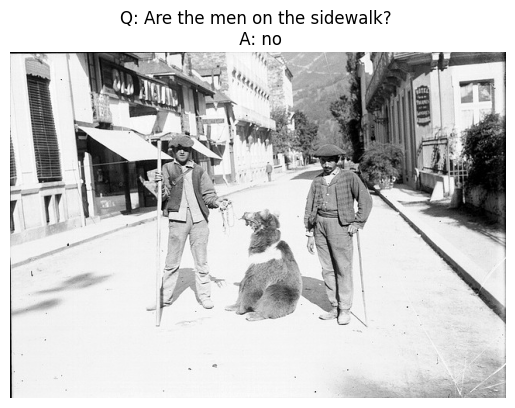

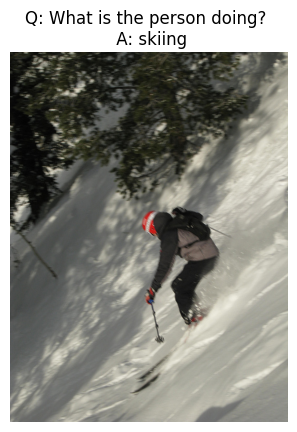

In [ ]:
plt.figure()
plt.title(f"Q: {merged_QA_df.loc[25, 'question']} \n A: {merged_QA_df.loc[25, 'multiple_choice_answer']}")
image = Image.open(merged_QA_df.loc[25, 'image_path'])
plt.imshow(image)
plt.axis('off')

plt.figure()
plt.title(f"Q: {merged_QA_df.loc[5, 'question']} \n A: {merged_QA_df.loc[5, 'multiple_choice_answer']}")
image = Image.open(merged_QA_df.loc[5, 'image_path'])
plt.imshow(image)
plt.axis('off')

In [ ]:
def clean_questions(text):
    text = text.lower()
    text = contractions.fix(text)
    text = re.sub('[^A-Za-z0-9]+', ' ', text)
    return text

merged_QA_df['question'] = merged_QA_df['question'].apply(lambda q: clean_questions(q))

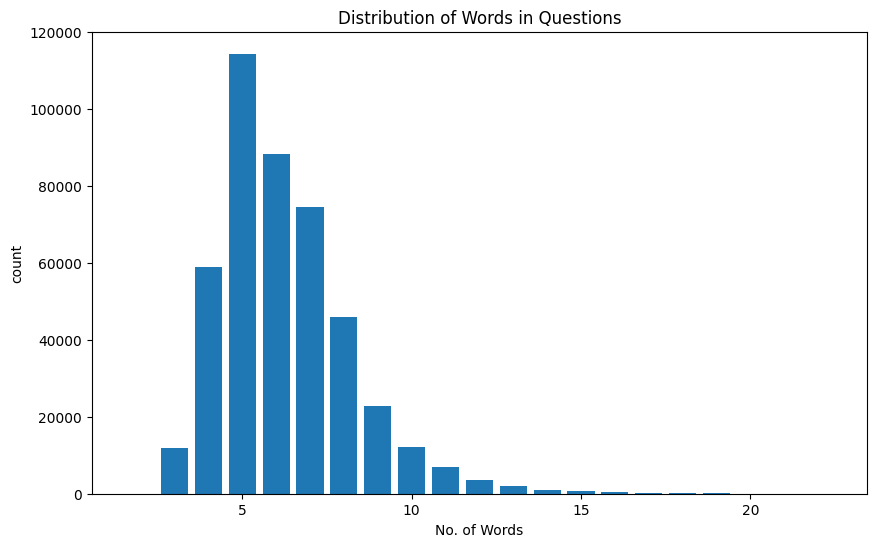

In [ ]:
words = merged_QA_df['question'].apply(lambda x: len(word_tokenize(x)))
word_counter = Counter(words) #Create a counter for word frequency
plt.figure(figsize=(10, 6))
plt.bar(word_counter.keys(), word_counter.values())
plt.xlabel('No. of Words')
plt.ylabel('count')
plt.title('Distribution of Words in Questions')
plt.show()

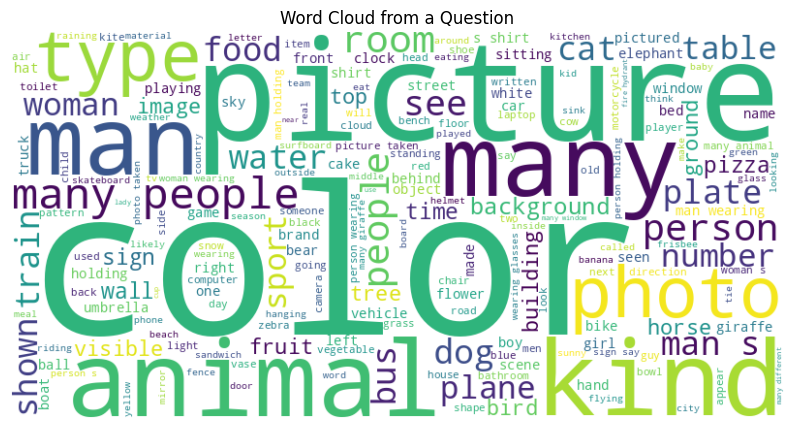

In [ ]:
words = merged_QA_df['question'].values
text = ' '.join(words)
# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
# Display the word cloud using Matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Turn off axis labels
plt.title('Word Cloud from a Question')
plt.show()

In [ ]:
print("Total No. of unique question_type: ", merged_QA_df['question_type'].nunique())

Total No. of unique question_type:  65


In [ ]:
# Calculating frequency of question_types
question_type_top30 = merged_QA_df['question_type'].value_counts().sort_values(ascending=False).head(30)
print(question_type_top30)

how many               42339
is the                 34927
what                   34608
what color is the      27962
what is the            24502
none of the above      16973
is this                16444
is this a              16024
what is                13561
what kind of           11192
are the                10701
is there a              9982
what type of            7962
is it                   7345
what are the            7225
where is the            6734
is there                6513
what color are the      6183
does the                6103
is                      6079
are there               5877
are these               5782
which                   5382
what is the man         5238
is the man              4972
are                     4912
how                     4740
does this               4396
how many people are     4276
what is on the          4254
Name: question_type, dtype: int64


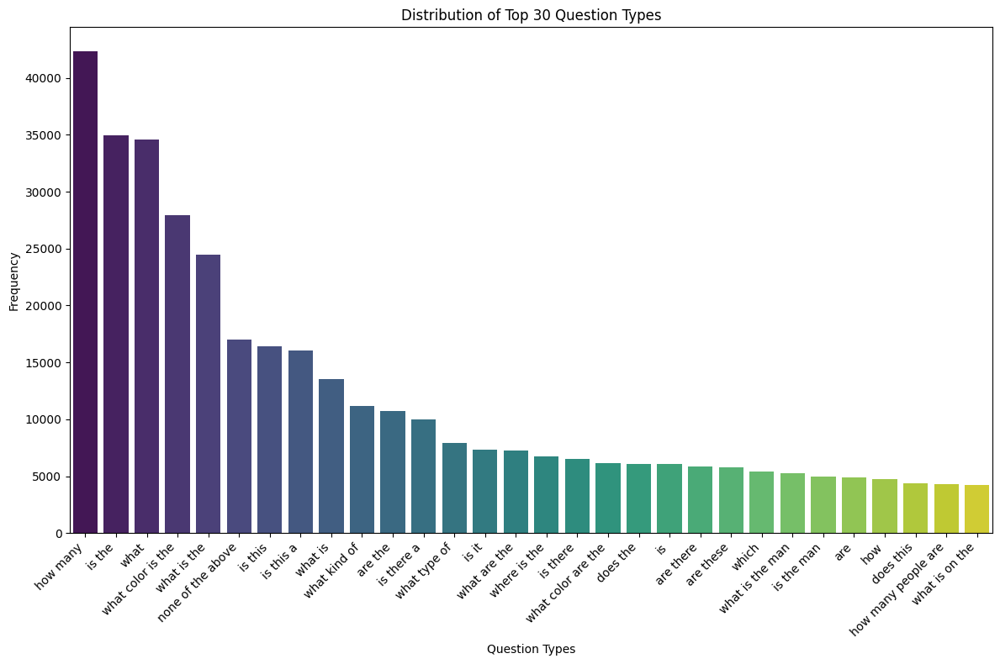

In [ ]:
plt.figure(figsize=(12, 8))
sns.barplot(x=question_type_top30.index, y=question_type_top30.values, palette="viridis")
plt.xticks(rotation=45, ha='right')
plt.xlabel('Question Types')
plt.ylabel('Frequency')
plt.title('Distribution of Top 30 Question Types')
plt.tight_layout()
plt.show()

## EDA on Answers

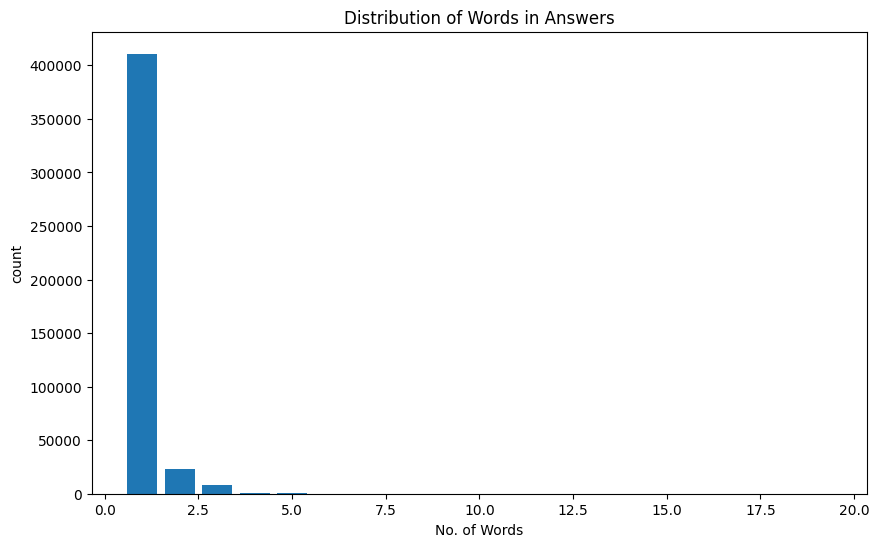

In [ ]:
ans_words = merged_QA_df['multiple_choice_answer'].apply(lambda x: len(word_tokenize(x)))
ans_wc = Counter(ans_words) #Create a counter for word frequency
plt.figure(figsize=(10, 6))
plt.bar(ans_wc.keys(), ans_wc.values())
plt.xlabel('No. of Words')
plt.ylabel('count')
plt.title('Distribution of Words in Answers')
plt.show()

In [ ]:
ans_wc

Counter({1: 410857,
         3: 7784,
         2: 23156,
         4: 1055,
         9: 36,
         5: 504,
         6: 181,
         11: 5,
         7: 113,
         8: 39,
         18: 2,
         10: 14,
         13: 3,
         19: 2,
         14: 2,
         12: 4})

In [ ]:
#choosing datapointswith only 1 word answers
merged_QA_df = merged_QA_df[ans_words == 1]

In [ ]:
merged_QA_df.shape

(410857, 6)

In [ ]:
#merged_QA_df['multiple_choice_answer'].value_counts()
merged_QA_df = merged_QA_df[merged_QA_df['multiple_choice_answer'].isin(merged_QA_df['multiple_choice_answer'].value_counts()[:100].keys())]
merged_QA_df.shape

(307568, 6)

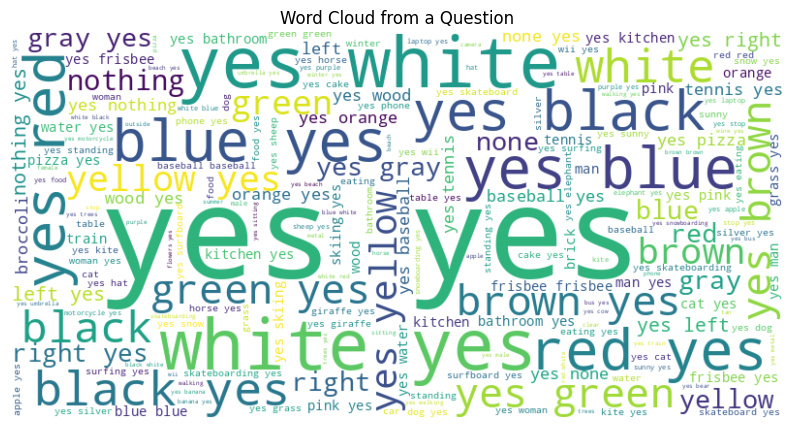

In [ ]:
words = merged_QA_df['multiple_choice_answer'].values
text = ' '.join(words)
# Generate the word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)
# Display the word cloud using Matplotlib
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')  # Turn off axis labels
plt.title('Word Cloud from a Question')
plt.show()

In [ ]:
print("Count of Diferent answer types:", merged_QA_df['answer_type'].nunique())
print("Diferent answer types:", merged_QA_df['answer_type'].unique())

Count of Diferent answer types: 3
Diferent answer types: ['other' 'yes/no' 'number']


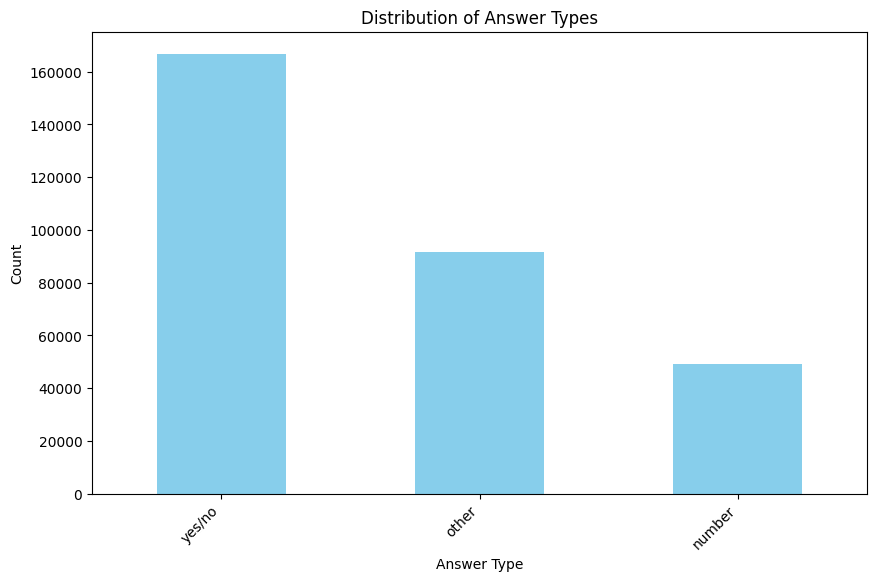

In [ ]:
answer_type_counts = merged_QA_df['answer_type'].value_counts()

# Plotting the distribution
plt.figure(figsize=(10, 6))
answer_type_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Answer Types')
plt.xlabel('Answer Type')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')
plt.show()

In [ ]:
# Calculating frequency of multiple_choice_answer
ans_type_top30 = merged_QA_df['multiple_choice_answer'].value_counts().sort_values(ascending=False).head(30)

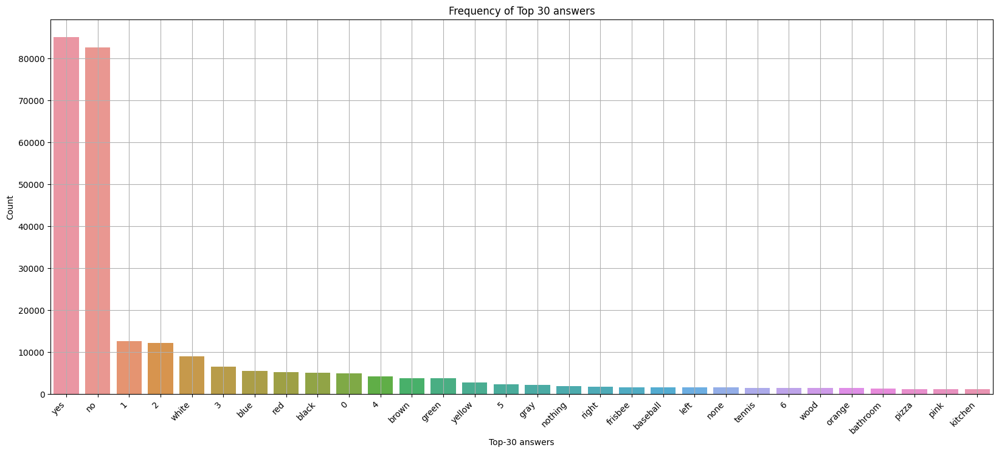

In [ ]:

plt.figure(figsize=(20,8))
sns.barplot(x=ans_type_top30.keys(), y=ans_type_top30.values)
plt.title(f"Frequency of Top 30 answers")
plt.xlabel("Top-30 answers")
plt.xticks(rotation=45, ha='right')
plt.ylabel("Count")
plt.grid()
plt.show()

#EDA On Images

In [ ]:
img_shapes = merged_QA_df['image_path'].apply(lambda x: Image.open(x).size)
img_heights = [img_shape[0] for img_shape in img_shapes]
img_widths =  [img_shape[1] for img_shape in img_shapes]

print("Number of unique values in heights: ", len(set(img_heights)))
print("Number of unique values in widths: ", len(set(img_widths)))

Number of unique values in heights:  439
Number of unique values in widths:  503


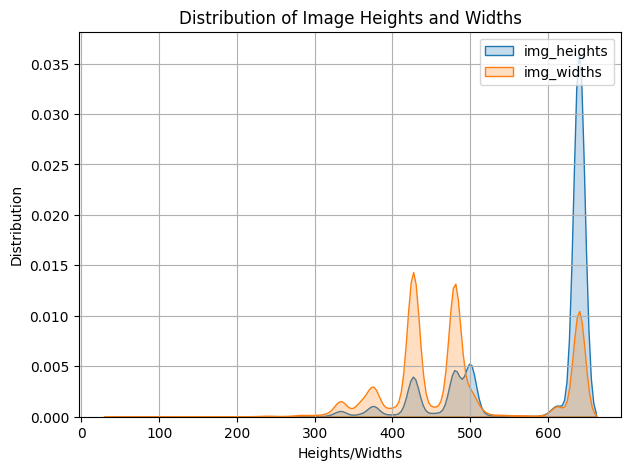

In [ ]:
plt.figure(figsize=(7, 5))

sns.kdeplot(img_heights, label="img_heights", fill=True)
sns.kdeplot(img_widths, label="img_widths", fill=True)

plt.title('Distribution of Image Heights and Widths')
plt.xlabel('Heights/Widths')
plt.ylabel('Distribution')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
import cv2

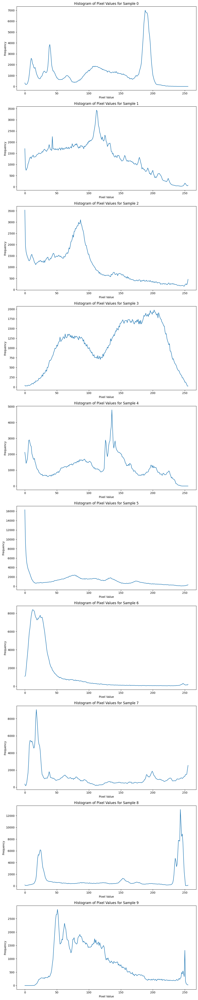

In [ ]:
def calculate_histogram(image_path):
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    hist,bins = np.histogram(image.flatten(),bins=256,range=[0,256])
    return hist

#Taking 10 random samples to view hist of pixel values
random_samples = merged_QA_df.sample(n=10, random_state=42)
random_samples['histogram'] = random_samples['image_path'].apply(calculate_histogram)

num_samples = len(random_samples)
fig,axes = plt.subplots(num_samples,1,figsize=(10,5*num_samples))
for i in range(num_samples):
    axes[i].plot(random_samples['histogram'].iloc[i])
    axes[i].set_title(f"Histogram of Pixel Values for Sample {i}")
    axes[i].set_xlabel("Pixel Value")
    axes[i].set_ylabel("Frequency")

plt.tight_layout()
plt.show()

In [ ]:
mean_pixel_values = merged_QA_df['image_path'].apply(lambda path: cv2.imread(path).mean())
plt.hist(mean_pixel_values, bins=50, color='blue', alpha=0.7)
plt.title('Distribution of Mean Pixel Values')
plt.xlabel('Mean Pixel Value')
plt.ylabel('Frequency')
plt.show()

KeyboardInterrupt: ignored

In [ ]:
plt.hist(mean_pixel_values, bins=50, color='blue', alpha=0.7)
plt.title('Distribution of Mean Pixel Values')
plt.xlabel('Mean Pixel Value')
plt.ylabel('Frequency')
plt.show()

In [ ]:
def get_image_channels(image_path):
    image = cv2.imread(image_path)
    return image.shape[2] if image.ndim == 3 else 1

# Apply the function to each row in the DataFrame
merged_QA_df['num_channels'] = merged_QA_df['image_path'].apply(get_image_channels)

# Count the number of RGB and grayscale images
num_rgb_images = merged_QA_df[merged_QA_df['num_channels'] == 3].shape[0]
num_gray_images = merged_QA_df[merged_QA_df['num_channels'] == 1].shape[0]

print(f"Number of RGB images: {num_rgb_images}")
print(f"Number of grayscale images: {num_gray_images}")

In [ ]:
merged_QA_df.head(12)

## Model Building

In [ ]:
data,_ = train_test_split(merged_QA_df, train_size=int(5.e4), stratify=merged_QA_df['answer_type'], random_state=30)
data.shape

(50000, 6)

In [ ]:
train_data, val_data = train_test_split(data, train_size=0.8, stratify=data['answer_type'], random_state=30)

print("Shape of train data: ", train_data.shape)
print("Shape of validation data: ", val_data.shape)

Shape of train data:  (40000, 6)
Shape of validation data:  (10000, 6)


In [ ]:
from sklearn.preprocessing import OneHotEncoder

ohe = OneHotEncoder(sparse=False)
ohe.fit(train_data['multiple_choice_answer'].values.reshape(-1,1))

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_encoders.py:868: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


OneHotEncoder(sparse=False, sparse_output=False)

In [ ]:
print("Number of answers: ", len(ohe.categories_[0]))
ohe.categories_

Number of answers:  100


[array(['0', '1', '10', '11', '12', '2', '20', '3', '4', '5', '6', '7',
        '8', '9', 'apple', 'banana', 'baseball', 'bathroom', 'beach',
        'bear', 'black', 'blue', 'brick', 'broccoli', 'brown', 'bus',
        'cake', 'camera', 'car', 'cat', 'clear', 'cow', 'dog', 'donut',
        'eating', 'elephant', 'female', 'flowers', 'food', 'frisbee',
        'giraffe', 'grass', 'gray', 'green', 'hat', 'horse', 'kitchen',
        'kite', 'laptop', 'left', 'male', 'man', 'many', 'metal',
        'motorcycle', 'no', 'none', 'nothing', 'orange', 'outside',
        'phone', 'pink', 'pizza', 'plane', 'purple', 'red', 'right',
        'sandwich', 'sheep', 'silver', 'sitting', 'skateboard',
        'skateboarding', 'skiing', 'snow', 'snowboarding', 'soccer',
        'standing', 'stop', 'summer', 'sunny', 'surfboard', 'surfing',
        'table', 'tan', 'tennis', 'tile', 'train', 'trees', 'umbrella',
        'walking', 'water', 'white', 'wii', 'wine', 'winter', 'woman',
        'wood', 'yellow'

**Observation : **
- we have restricted the problem to one worded answers. One worded answers can be numbers or yes/no or general answer.

In [ ]:
tokenize = Tokenizer(oov_token='oov_token')
# fit on train data
tokenize.fit_on_texts(train_data['question'])
# indices for each of the word in the vocab
WORD_INDEX = tokenize.word_index

In [ ]:
EMBEDDING_DIM = 300

import pickle

with open("glove_vectors", "rb") as f:
    glove = pickle.load(f)
    glove_words = set(glove.keys())
vocab_len = len(tokenize.word_index) + 1

#Creating embedding matrix
embed_matrix = np.zeros((vocab_len, 300))
for word, i in tokenize.word_index.items():
    if word in glove_words:
        embed_matrix[i] = glove[word]

In [ ]:
glove_embedding_layer = Embedding(vocab_len, EMBEDDING_DIM, weights=[embed_matrix], input_length=22,name='GLOVE_embedding_layer',trainable=False)

In [ ]:
IMG_TARGET_SIZE=(224, 224)

In [ ]:
vgg16_model = VGG16(input_shape= (224,224,3),weights='imagenet')
vgg16_model.trainable = False

# Create a model that outputs activations from vgg16's last hidden layer
vgg_featurizer = Model(inputs=vgg16_model.inputs, outputs=vgg16_model.layers[-2].output)
vgg_featurizer.trainable = False
vgg_featurizer.summary()



553467096/553467096 [==============================] - 2s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                            

In [ ]:
import keras.utils as image

In [ ]:
class Baseline_Model:
    def __init__(self, data,img_target_size, tokenize, embd_layer, max_len, vgg_featurizer, ohe):
        self.length, self.img_target_size = len(data), img_target_size
        self.questions, self.images = data['question'].values, data['image_path'].values
        self.tknizer = tokenize
        self.embd_layer = embd_layer
        self.max_len = max_len
        self.vgg_featurizer = vgg_featurizer
        self.answers = data['multiple_choice_answer'].values
        self.ohe = ohe

    def __getitem__(self, i):
        text = clean_questions(self.questions[i])
        encoded_seq = self.tknizer.texts_to_sequences([text])
        encoded_seq = pad_sequences(encoded_seq, maxlen=self.max_len, dtype='int32', padding='post')
        encoded_seq = self.embd_layer(encoded_seq)[0]
        img = image.load_img(self.images[i], target_size=self.img_target_size)
        img_arr = image.img_to_array(img)
        img_arr = preprocess_input(img_arr)
        # vgg_featurizer
        vgg_feats = self.vgg_featurizer(np.expand_dims(img_arr, axis=0))[0]
        #one-hot encode answer
        ohe_answer = self.ohe.transform(np.asarray([[self.answers[i]]]))[0]
        return encoded_seq, vgg_feats, ohe_answer

    def __len__(self):
        return self.length



In [ ]:
class DataLoader(tf.keras.utils.Sequence):
    def __init__(self, dataset, batch_size=1, shuffle=True, shuffle_every_epoch=False, data_augmentation=None):
        self.dataset = dataset
        self.batch_size = batch_size
        self.shuffle = shuffle
        self.shuffle_every_epoch = shuffle_every_epoch
        self.indexes = np.arange(len(dataset))
        if self.shuffle:self.indexes = np.random.permutation(self.indexes)

    def __getitem__(self, i):
        # collect batch data
        start = i * self.batch_size
        stop = (i + 1) * self.batch_size
        data = list()
        for j in range(start, stop):
            data.append(self.dataset[self.indexes[j]])
        batch = [np.stack(samples, axis=0) for samples in zip(*data)]
        return tuple([[batch[0],batch[1]],batch[2]])

    def __len__(self):
        return len(self.indexes) // self.batch_size

    def on_epoch_end(self):
        if self.shuffle_every_epoch:self.indexes = np.random.permutation(self.indexes)


In [ ]:
MAX_SEQUENCE_LENGTH = 22
train_dataset = Baseline_Model(train_data, IMG_TARGET_SIZE, tokenize, glove_embedding_layer, MAX_SEQUENCE_LENGTH, vgg_featurizer, ohe)
val_dataset  = Baseline_Model(val_data,IMG_TARGET_SIZE, tokenize, glove_embedding_layer, MAX_SEQUENCE_LENGTH, vgg_featurizer, ohe)

BATCH_SIZE = 512
#creating data loaders
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle_every_epoch=True)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle_every_epoch=True)

In [ ]:
feats, ans = train_dataloader[0]
ques_feats, img_feats = feats
print("Batch shape of image features: ", img_feats.shape)
print("Batch shape of question features: ", ques_feats.shape)
print("Batch shape of one-hot encoded answers: ", ans.shape)


Batch shape of image features:  (512, 4096)
Batch shape of question features:  (512, 22, 300)
Batch shape of one-hot encoded answers:  (512, 100)


In [ ]:

def lrate_scheduler(epoch, lr):
    decay_rate = .95
    if (epoch ) % 3 == 0 :
        return lr * decay_rate

    return lr



In [ ]:
checkpoint = ModelCheckpoint(filepath = "bestmodel_baselinemodel_{val_accuracy:.4f}.hdf5",monitor='val_accuracy',verbose = 1,save_best_only = True,mode = "auto")

earlystop = EarlyStopping(monitor = "val_accuracy", patience = 5, verbose = 1)
reduce_lrate = ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=1, min_lr=0.0001)
lrateschedule = LearningRateScheduler(lrate_scheduler, verbose=0)
logdir = os.path.join("baselinemodel",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logdir, histogram_freq = 1, write_graph = True)

callback_list = [checkpoint, earlystop, reduce_lrate,lrateschedule,tensorboard_callback]

In [ ]:
ques = Input(shape=(MAX_SEQUENCE_LENGTH,EMBEDDING_DIM))
# Pass the embeddings from above to a two-layer LSTM

lstm_1 = LSTM(256, return_sequences=True,return_state=True)
lstm_out_1, lstm_out_2, lstm_out_3 = lstm_1(ques)

lstm_2 = LSTM(256, return_sequences=True,return_state=True)
_,lstm_out_2_2,lstm_out_2_3 = lstm_2(lstm_out_1)

# Concatenate cell states and hidden states from the above two LSTMs
concatenated_features = concatenate(inputs=[lstm_out_3, lstm_out_3, lstm_out_2_3, lstm_out_2_2],name='concatenate')
print(concatenated_features.get_shape())
ques_features = Dense(1024, activation='relu', kernel_initializer=tf.keras.initializers.he_normal())(concatenated_features)
print(ques_features.get_shape())

#Image features
img = Input(shape=(4096,), name='vgg_activations')
#l2_normed_vgg16_features = tf.norm(img, ord='euclidean', axis=1,keepdims = True)
l2_normed_vgg16_features = tf.math.l2_normalize(img, axis=1, epsilon=1e-10)
img_features = Dense(1024, activation='relu',kernel_initializer=tf.keras.initializers.he_normal(),)(l2_normed_vgg16_features)

#Concatenating Image and text features
concat_img_text = Multiply()([ques_features, img_features])

#Generating Answers
batch_norm1 = BatchNormalization()(concat_img_text)
drop_out1 = Dropout(0.3)(batch_norm1)
dense2 =Dense(256, activation='relu',kernel_initializer = tf.keras.initializers.he_normal())(drop_out1)

batch_norm2 = BatchNormalization()(dense2)
drop_out2 = Dropout(0.1)(batch_norm2)
dense3 = Dense(256, activation='relu', kernel_initializer=tf.keras.initializers.he_normal())(drop_out2)

final_out = Dense(100, activation='softmax',kernel_initializer=tf.keras.initializers.glorot_uniform())(dense3)
print(final_out.get_shape())

model_1 = Model(inputs=[ques,img], outputs=final_out)
model_1.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model_1.fit(train_dataloader,steps_per_epoch=15, epochs=10,verbose=1, shuffle=True,validation_data=val_dataloader, validation_steps=10, callbacks=callback_list)



(None, 1024)
(None, 1024)
(None, 100)
Epoch 1/10
15/15 [==============================] - ETA: 0s - loss: 3.2867 - accuracy: 0.2193
Epoch 1: val_accuracy improved from -inf to 0.27500, saving model to bestmodel_baselinemodel_0.2750.hdf5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


15/15 [==============================] - 291s 20s/step - loss: 3.2867 - accuracy: 0.2193 - val_loss: 4.4197 - val_accuracy: 0.2750 - lr: 9.5000e-04
Epoch 2/10
15/15 [==============================] - ETA: 0s - loss: 2.0598 - accuracy: 0.3397
Epoch 2: val_accuracy improved from 0.27500 to 0.34434, saving model to bestmodel_baselinemodel_0.3443.hdf5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


15/15 [==============================] - 277s 19s/step - loss: 2.0598 - accuracy: 0.3397 - val_loss: 4.1509 - val_accuracy: 0.3443 - lr: 9.5000e-04
Epoch 3/10
15/15 [==============================] - ETA: 0s - loss: 1.8347 - accuracy: 0.3613
Epoch 3: val_accuracy improved from 0.34434 to 0.34805, saving model to bestmodel_baselinemodel_0.3480.hdf5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


15/15 [==============================] - 276s 19s/step - loss: 1.8347 - accuracy: 0.3613 - val_loss: 4.0031 - val_accuracy: 0.3480 - lr: 9.5000e-04
Epoch 4/10
 8/15 [===============>..............] - ETA: 1:09 - loss: 1.7260 - accuracy: 0.3738

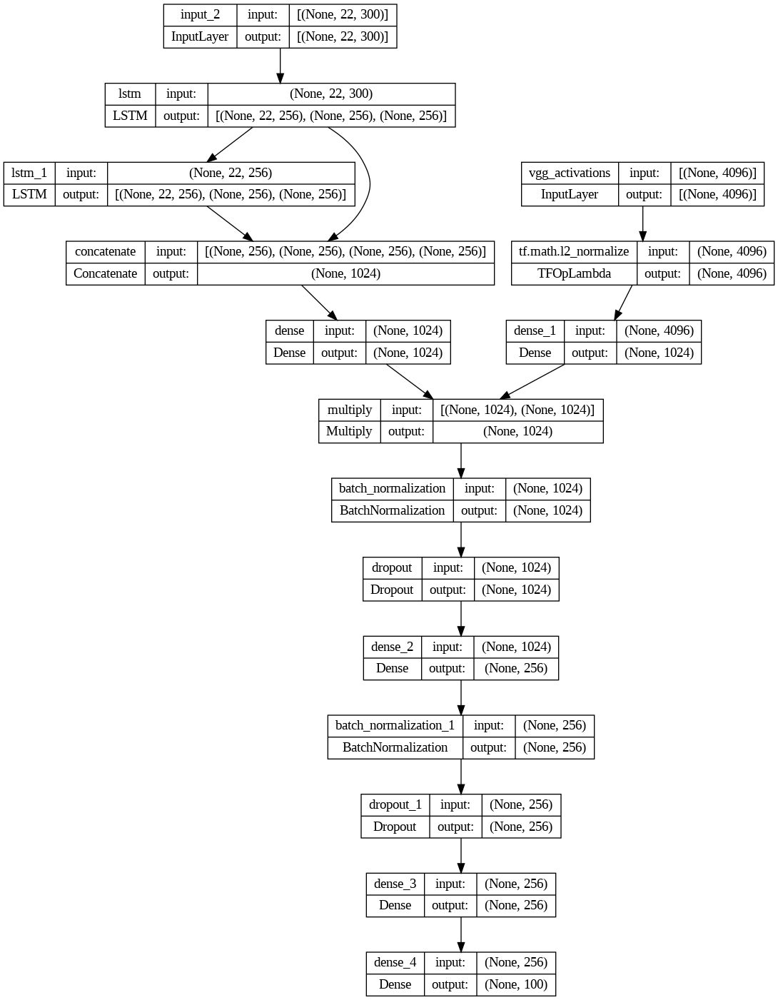

In [ ]:
plot_model(model_1, show_shapes=True)

In [ ]:
loss, accuracy = model_1.evaluate(val_dataloader, verbose=0)

In [ ]:
print("Val Loss: {}".format(loss))
print("Val Accuracy: {}".format(accuracy))

In [ ]:
#%load_ext tensorboard
%tensorboard --logdir $logdir

# Model 2 : BERT embeddings on Questions + RESNET embeddings on Images.

In [ ]:
#Loading the Pretrained Model from tensorflow HUB
import tensorflow_hub as hub
tf.keras.backend.clear_session()

#maximum length of a seq in the data s
max_seq_length = 100

#BERT takes 3 inputs
#this is input words. Sequence of words represented as integers
input_word_ids = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32, name="input_word_ids")

#mask vector if you are padding anything
input_mask = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32, name="input_mask")

#segment vectors.
segment_ids = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32, name="segment_ids")

#bert layer
bert_layer = hub.KerasLayer("https://tfhub.dev/tensorflow/bert_en_uncased_L-12_H-768_A-12/1", trainable=False)
pooled_output, sequence_output = bert_layer([input_word_ids, input_mask, segment_ids])

#Bert model
#We are using only pooled output not sequence out.
bert_model = Model(inputs=[input_word_ids, input_mask, segment_ids], outputs=pooled_output)
bert_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_word_ids (InputLayer  [(None, 100)]                0         []                            
 )                                                                                                
                                                                                                  
 input_mask (InputLayer)     [(None, 100)]                0         []                            
                                                                                                  
 segment_ids (InputLayer)    [(None, 100)]                0         []                            
                                                                                                  
 keras_layer (KerasLayer)    [(None, 768),                1094822   ['input_word_ids[0][0]',  

In [ ]:
bert_model.output

In [ ]:
!pip install sentencepiece

In [ ]:
#getting Vocab file
vocab_file = bert_layer.resolved_object.vocab_file.asset_path.numpy()
do_lower_case = bert_layer.resolved_object.do_lower_case.numpy()

In [ ]:
from tokenization import FullTokenizer
tokenizer = FullTokenizer(vocab_file,do_lower_case )

In [ ]:

def TokenizeReview(sentence, tokenizer):
      ids_list, masks_list, segments_list = list(), list(), list()
      #adding '[CLS]' at start of the Tokens and '[SEP]' at the end of the tokens.
      tokens = tokenizer.tokenize(sentence)
      tokens = tokens[0: max_seq_length-2]

      # add 'CLS' for start token and 'SEP' as end token
      tokens = ['[CLS]',*tokens,'[SEP]']

      ids = tokenizer.convert_tokens_to_ids(tokens)

      ids.extend([0]*(max_seq_length - len(tokens)))

      #Based on padding, create the mask for Train and Test ( 1 for real token, 0 for '[PAD]'),
      mask = np.array([1]*len(tokens) + [0]*(max_seq_length - len(tokens)))

      #Create a segment input for train and test.
      segment = np.array([0]*max_seq_length)

      ids_list.append(ids)
      masks_list.append(mask)
      segments_list.append(segment)

      return np.array(ids_list),np.array(masks_list),np.array(segments_list)


In [ ]:
resnet50_model = resnet50.ResNet50(input_shape=(224,224,3),weights='imagenet')

# Create a model that outputs activations from resnet50's last hidden layer
resnet50_featurizer = Model(inputs=resnet50_model.inputs, outputs=resnet50_model.layers[-2].output)
resnet50_featurizer.trainable = False

resnet50_featurizer.summary()

Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_16 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_16[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [ ]:
class Data_model_2:
    def __init__(self, data, img_target_size, tknizer,TokenizeReview,bert_featurizer, resnet50_featurizer, ohe):
        self.length, self.img_target_size = len(data), img_target_size
        self.questions, self.images = data['question'].values, data['image_path'].values
        self.tknizer = tknizer
        self.tokenizetext = TokenizeReview
        self.bert_featurizer, self.resnet50_featurizer = bert_featurizer,resnet50_featurizer
        self.answers = data['multiple_choice_answer'].values
        self.ohe = ohe

    def __getitem__(self, i):
        text = clean_questions(self.questions[i])
        tokens, mask, segment = self.tokenizetext(text,self.tknizer)

        pool_out = self.bert_featurizer([tokens,mask,segment])[0]
        img = image.load_img(self.images[i], target_size=self.img_target_size)
        img_arr = image.img_to_array(img)
        img_arr = resnet50.preprocess_input(img_arr)
        resnet_feats = self.resnet50_featurizer(np.expand_dims(img_arr, axis=0))[0]

        # one-hot encode answer
        ohe_answer = self.ohe.transform(np.asarray([[self.answers[i]]]))[0]

        return pool_out, resnet_feats, ohe_answer

    def __len__(self):
        return self.length

In [ ]:
train_dataset = Data_model_2(train_data,IMG_TARGET_SIZE, tokenizer,TokenizeReview,bert_model,resnet50_featurizer, ohe)
val_dataset  = Data_model_2(val_data,IMG_TARGET_SIZE, tokenizer,TokenizeReview,bert_model,resnet50_featurizer, ohe)

BATCH_SIZE = 512

# creating data loaders
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle_every_epoch=True)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle_every_epoch=True)




In [ ]:
feats, ans = train_dataloader[0]
ques_feats, img_feats = feats
print("Batch shape of image features: ", img_feats.shape)
print("Batch shape of question features: ", ques_feats.shape)
print("Batch shape of one-hot encoded answers: ", ans.shape)


Batch shape of image features:  (512, 2048)
Batch shape of question features:  (512, 768)
Batch shape of one-hot encoded answers:  (512, 100)


In [ ]:

earlystop = EarlyStopping(monitor = "val_accuracy", patience = 5, verbose = 1)
reduce_lrate = ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=1, min_lr=0.0001)
lrateschedule = LearningRateScheduler(lrate_scheduler, verbose=0)
logdir = os.path.join("model2",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logdir, histogram_freq = 1, write_graph = True)

callback_list_2 = [earlystop, reduce_lrate, lrateschedule,tensorboard_callback]

In [ ]:
ques_input = Input(shape=(768, ))
print(ques_input.get_shape())

ques_features = Dense(32, activation='relu', kernel_initializer=tf.keras.initializers.he_normal(seed=33))(ques_input)
print(ques_features.get_shape())

# Image Features
img_input = Input(shape=(2048,))
print(img_input.get_shape())

l2_normed_resnet_features = tf.math.l2_normalize(img_input, axis=1, epsilon=1e-12, name='l2_norm')
print(l2_normed_resnet_features.get_shape())

img_features = Dense(32, activation='relu',kernel_initializer=tf.keras.initializers.he_normal(),)(l2_normed_resnet_features)
print(img_features.get_shape())

# Merge Image and Question embeddings using pointwise multiplication
joint_feat_rep = Multiply()([ques_features, img_features])
print(joint_feat_rep.get_shape())


# Generate Answers
batch_norm_1 = BatchNormalization(name='batch_norm_1')(joint_feat_rep)
drop_out_1 = Dropout(0.1, name='dropout_1')(batch_norm_1)
d1=Dense(32, activation='relu', name='dense_1', kernel_initializer=tf.keras.initializers.he_normal)(drop_out_1)

final_output = Dense(100, activation='softmax', name='softmax_classification', kernel_initializer=tf.keras.initializers.glorot_uniform(seed=3))(d1)
print(final_output.get_shape())

model_2 = Model(inputs=[ques_input, img_input], outputs=final_output)
print(model_2.summary())

model_2.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

model_2.fit(train_dataloader, steps_per_epoch=20, epochs=5,validation_data=val_dataloader, validation_steps=10,
    callbacks=callback_list_2)


(None, 768)
(None, 32)
(None, 2048)
(None, 2048)
(None, 32)
(None, 32)
(None, 100)
Model: "model_14"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_24 (InputLayer)       [(None, 2048)]               0         []                            
                                                                                                  
 input_23 (InputLayer)       [(None, 768)]                0         []                            
                                                                                                  
 tf.math.l2_normalize_8 (TF  (None, 2048)                 0         ['input_24[0][0]']            
 OpLambda)                                                                                        
                                                                                                  
 dense_2

KeyboardInterrupt: ignored

In [ ]:
plot_model(model_2, show_shapes=True)

In [ ]:
loss, accuracy = model_2.evaluate(val_dataloader, verbose=0)

In [ ]:
print("Val Loss: {}".format(loss))
print("Val Accuracy: {}".format(accuracy))

In [ ]:
%tensorboard --logdir $logdir

# Model 3 - Taking output from pretrained VGG16. After VGG-16 network without FC layers, add a new Conv block ( 1 Conv layer and 1 Maxpooling ), 1 FC layer

Final architecture will be INPUT --> VGG-16 without Top layers(FC) --> 2 Conv Layer --> Maxpool Layer --> 1 FC layers --> Image Embeddings

In [ ]:
from keras.layers import Dense, Conv2D, MaxPool2D , Flatten
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input

model = VGG16(input_shape= (224,224,3), weights='imagenet', include_top=False)

for layer in model.layers:
  layer.trainable = False

x = model.output

x = Conv2D(filters = 256,kernel_size=(3,3),padding="same", activation="relu")(x)
x = Conv2D(filters = 128,kernel_size=(3,3),padding="same", activation="relu")(x)
x = MaxPool2D(2,2)(x)
x = Flatten()(x)
out = Dense(1048, activation="relu")(x)
#vgg_featurizer = Model(inputs=vgg16_model.inputs, outputs=vgg16_model.layers[-2].output)
model3 = Model(inputs = model.inputs, outputs = out)
model3.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "model_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_11 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                            

In [ ]:
checkpoint = ModelCheckpoint(filepath = "bestmodel_model_3_{val_accuracy:.4f}.hdf5",monitor='val_accuracy',verbose = 1,save_best_only = True,mode = "auto")

earlystop = EarlyStopping(monitor = "val_accuracy", patience = 5, verbose = 1)
reduce_lrate = ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=1, min_lr=0.0001)
lrateschedule = LearningRateScheduler(lrate_scheduler, verbose=0)
logdir = os.path.join("model_3",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logdir, histogram_freq = 1, write_graph = True)

callback_list_3= [checkpoint, earlystop, reduce_lrate,lrateschedule,tensorboard_callback]

In [ ]:
class Data_model_3:
    def __init__(self, data,img_target_size, tokenize, embd_layer, max_len, vgg_featurizer, ohe):
        self.length, self.img_target_size = len(data), img_target_size
        self.questions, self.images = data['question'].values, data['image_path'].values
        self.tknizer = tokenize
        self.embd_layer = embd_layer
        self.max_len = max_len
        self.vgg_featurizer = vgg_featurizer
        self.answers = data['multiple_choice_answer'].values
        self.ohe = ohe

    def __getitem__(self, i):
        text = clean_questions(self.questions[i])
        encoded_seq = self.tknizer.texts_to_sequences([text])
        encoded_seq = pad_sequences(encoded_seq, maxlen=self.max_len, dtype='int32', padding='post')
        encoded_seq = self.embd_layer(encoded_seq)[0]
        img = image.load_img(self.images[i], target_size=self.img_target_size)
        img_arr = image.img_to_array(img)
        img_arr = preprocess_input(img_arr)
        # vgg_featurizer
        vgg_feats = self.vgg_featurizer(np.expand_dims(img_arr, axis=0))[0]
        #one-hot encode answer
        ohe_answer = self.ohe.transform(np.asarray([[self.answers[i]]]))[0]
        return encoded_seq, vgg_feats, ohe_answer

    def __len__(self):
        return self.length


In [ ]:

earlystop = EarlyStopping(monitor = "val_accuracy", patience = 5, verbose = 1)
reduce_lrate = ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=1, min_lr=0.0001)
lrateschedule = LearningRateScheduler(lrate_scheduler, verbose=0)
logdir = os.path.join("model3",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logdir, histogram_freq = 1, write_graph = True)

callback_list = [earlystop, reduce_lrate,lrateschedule,callback_list_3]

In [ ]:
MAX_SEQUENCE_LENGTH = 22
train_dataset = Data_model_3(train_data, IMG_TARGET_SIZE, tokenize, glove_embedding_layer, MAX_SEQUENCE_LENGTH, model3, ohe)
val_dataset  = Data_model_3(val_data,IMG_TARGET_SIZE, tokenize, glove_embedding_layer, MAX_SEQUENCE_LENGTH, model3, ohe)

BATCH_SIZE = 256
#creating data loaders
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle_every_epoch=True)
val_dataloader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle_every_epoch=True)

In [ ]:
feats, ans = train_dataloader[0]
ques_feats, img_feats = feats
print("Batch shape of image features: ", img_feats.shape)
print("Batch shape of question features: ", ques_feats.shape)
print("Batch shape of one-hot encoded answers: ", ans.shape)

In [ ]:
ques = Input(shape=(MAX_SEQUENCE_LENGTH, EMBEDDING_DIM))
lstm_1 = LSTM(128, return_sequences=True,return_state=True)
lstm_out_1, lstm_out_2, lstm_out_3 = lstm_1(ques)

lstm_2 = LSTM(256, return_sequences=True,return_state=True)
_,lstm_out_2_2,lstm_out_2_3 = lstm_2(lstm_out_1)

#concat cell and hidden states of two LSTM's
concat_feat = concatenate(inputs=[lstm_out_3, lstm_out_3, lstm_out_2_3, lstm_out_2_2])
print(concat_feat.get_shape())
ques_features = Dense(1024, activation='relu', kernel_initializer=tf.keras.initializers.he_normal())(concat_feat)
print(ques_features.get_shape())
# Learnable scalar weight for text embeddings
text_weight = Dense(1,activation='sigmoid',use_bias=False)(ques_features)

#Multiply text embeddings by the learnable weight
weighted_text_embeddings = Multiply(name='weighted_text_embeddings')([ques_features, text_weight])

#Image features
img = Input(shape=(1048,))
#l2_normed_vgg16_features = tf.norm(img, ord='euclidean', axis=1,keepdims = True)
l2_normed_img_features = tf.math.l2_normalize(img, axis=1, epsilon=1e-10)
img_features = Dense(1024, activation='relu',kernel_initializer=tf.keras.initializers.he_normal(),)(l2_normed_img_features)

#Concatenating Image and text features
concat_img_text = Multiply()([weighted_text_embeddings, img_features])

#Generating Answers
batch_norm1 = BatchNormalization()(concat_img_text)
drop_out1 = Dropout(0.3)(batch_norm1)
dense2 =Dense(256, activation='relu',kernel_initializer = tf.keras.initializers.he_normal())(drop_out1)

batch_norm2 = BatchNormalization()(dense2)
drop_out2 = Dropout(0.1)(batch_norm2)
dense3 = Dense(256, activation='relu', kernel_initializer=tf.keras.initializers.he_normal())(drop_out2)

final_out = Dense(100, activation='softmax',kernel_initializer=tf.keras.initializers.glorot_uniform())(dense3)
print(final_out.get_shape())

model_3 = Model(inputs=[ques,img], outputs=final_out)
model_3.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
model_3.fit(train_dataloader, steps_per_epoch = 25,epochs=10,verbose=1, shuffle=True,validation_data=val_dataloader, validation_steps=10, callbacks=callback_list)


(None, 768)
(None, 1024)
(None, 100)
Epoch 1/10
25/25 [==============================] - ETA: 0s - loss: 2.8591 - accuracy: 0.2580
Epoch 1: val_accuracy improved from -inf to 0.26836, saving model to bestmodel_model_3_0.2684.hdf5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


25/25 [==============================] - 215s 8s/step - loss: 2.8591 - accuracy: 0.2580 - val_loss: 4.4273 - val_accuracy: 0.2684 - lr: 9.0250e-04
Epoch 2/10
25/25 [==============================] - ETA: 0s - loss: 1.9945 - accuracy: 0.3494
Epoch 2: val_accuracy improved from 0.26836 to 0.28711, saving model to bestmodel_model_3_0.2871.hdf5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


25/25 [==============================] - 204s 8s/step - loss: 1.9945 - accuracy: 0.3494 - val_loss: 4.3987 - val_accuracy: 0.2871 - lr: 9.0250e-04
Epoch 3/10
25/25 [==============================] - ETA: 0s - loss: 1.8953 - accuracy: 0.3306
Epoch 3: val_accuracy did not improve from 0.28711
25/25 [==============================] - 201s 8s/step - loss: 1.8953 - accuracy: 0.3306 - val_loss: 4.3746 - val_accuracy: 0.2676 - lr: 7.3103e-04
Epoch 4/10
25/25 [==============================] - ETA: 0s - loss: 1.7705 - accuracy: 0.3547
Epoch 4: val_accuracy did not improve from 0.28711
25/25 [==============================] - 203s 8s/step - loss: 1.7705 - accuracy: 0.3547 - val_loss: 4.3383 - val_accuracy: 0.2594 - lr: 5.3440e-04
Epoch 5/10
25/25 [==============================] - ETA: 0s - loss: 1.7398 - accuracy: 0.3470
Epoch 5: val_accuracy did not improve from 0.28711
25/25 [==============================] - 201s 8s/step - loss: 1.7398 - accuracy: 0.3470 - val_loss: 4.2958 - val_accuracy: 0

In [ ]:
model_3.fit(train_dataloader, steps_per_epoch = 25,epochs=10,verbose=1, shuffle=True,validation_data=val_dataloader, validation_steps=10, callbacks=callback_list)

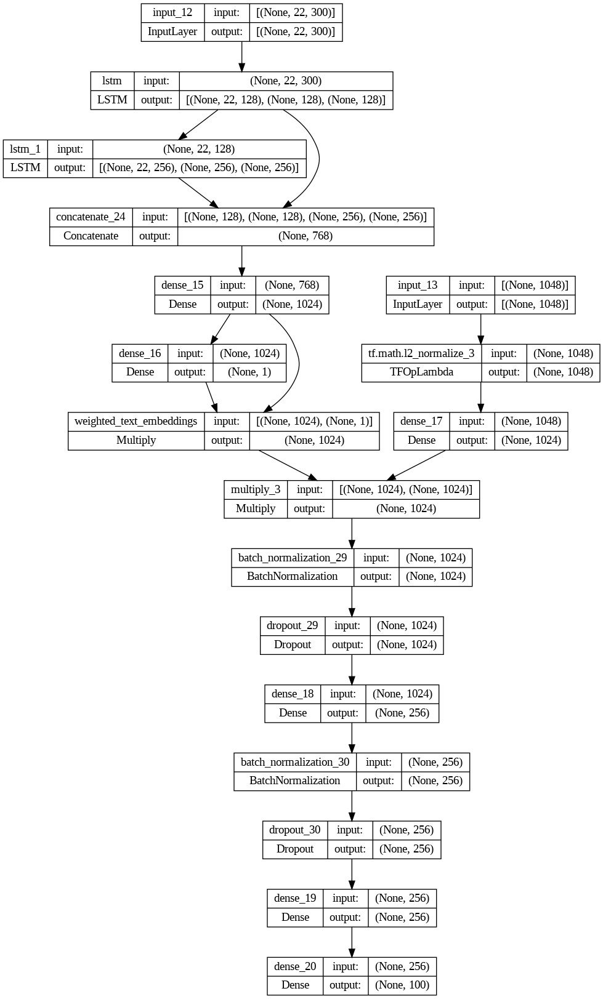

In [ ]:
plot_model(model_3, show_shapes=True)

In [ ]:
loss, accuracy = model_3.evaluate(val_dataloader, verbose=0)
print("Val Loss model_3: {}".format(loss))
print("Val Accuracy model_3: {}".format(accuracy))

In [ ]:
%reload_ext tensorboard

In [ ]:
%tensorboard --logdir $logdir

Reusing TensorBoard on port 6007 (pid 73168), started 0:01:59 ago. (Use '!kill 73168' to kill it.)

<IPython.core.display.Javascript object>

# Model 4 - EfficientNetB7 for Image embeddings and Bert for Text embeddings

In [ ]:
!pip install -U efficientnet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.7/50.7 kB 2.0 MB/s eta 0:00:00


In [ ]:
import efficientnet.keras as efn
from keras.layers import Dense, Conv2D, MaxPool2D , Flatten
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input

In [ ]:
efn_model = efn.EfficientNetB0(input_shape = (224, 224, 3), include_top = False, weights = 'imagenet')

for layer in efn_model.layers:
    layer.trainable = False

x = efn_model.output
x = Flatten()(x)
x = Dense(1024, activation="relu")(x)
x = Dropout(0.5)(x)

efn_featurizer = Model(inputs=efn_model.inputs, outputs=x)

efn_featurizer.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 stem_conv (Conv2D)          (None, 112, 112, 32)         864       ['input_3[0][0]']             
                                                                                                  
 stem_bn (BatchNormalizatio  (None, 112, 112, 32)         128       ['stem_conv[0][0]']           
 n)                                                                                               
                                                                                                  
 stem_activation (Activatio  (None, 112, 112, 32)         0         ['stem_bn[0][0]']       

In [ ]:
checkpoint = ModelCheckpoint(filepath = "bestmodel_model_4_{val_accuracy:.4f}.hdf5",monitor='val_accuracy',verbose = 1,save_best_only = True,mode = "auto")

earlystop = EarlyStopping(monitor = "val_accuracy", patience = 5, verbose = 1)
reduce_lrate = ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=1, min_lr=0.0001)
lrateschedule = LearningRateScheduler(lrate_scheduler, verbose=0)
logdir = os.path.join("model_4",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logdir, histogram_freq = 1, write_graph = True)

callback_list_4= [checkpoint, earlystop, reduce_lrate,lrateschedule,tensorboard_callback]

In [ ]:
from tensorflow.keras.applications.efficientnet import preprocess_input

In [ ]:
class Data_model_4:
    def __init__(self, data, img_target_size, tknizer,TokenizeReview,bert_featurizer, effnet_featurizer, ohe):
        self.length, self.img_target_size = len(data), img_target_size
        self.questions, self.images = data['question'].values, data['image_path'].values
        self.tknizer = tknizer
        self.tokenizetext = TokenizeReview
        self.bert_featurizer, self.effnet_featurizer = bert_featurizer,effnet_featurizer
        self.answers = data['multiple_choice_answer'].values
        self.ohe = ohe

    def __getitem__(self, i):
        text = clean_questions(self.questions[i])
        tokens, mask, segment = self.tokenizetext(text,self.tknizer)

        pool_out = self.bert_featurizer([tokens,mask,segment])[0]
        img = image.load_img(self.images[i], target_size=self.img_target_size)
        img_arr = image.img_to_array(img)
        #img_arr = preprocess_input(img_arr)
        effnet_feats = self.effnet_featurizer(np.expand_dims(img_arr, axis=0))[0]

        # one-hot encode answer
        ohe_answer = self.ohe.transform(np.asarray([[self.answers[i]]]))[0]

        return pool_out, effnet_feats, ohe_answer

    def __len__(self): # The model.fit_gen requires this function
        return self.length

In [ ]:

train_dataset = Data_model_4(train_data, IMG_TARGET_SIZE, tokenizer,TokenizeReview,bert_model ,efn_featurizer, ohe)
val_dataset  = Data_model_4(val_data,IMG_TARGET_SIZE, tokenizer,TokenizeReview, bert_model,efn_featurizer, ohe)

BATCH_SIZE = 256
#creating data loaders
train_dataloader = DataLoader(train_dataset,batch_size=BATCH_SIZE,shuffle_every_epoch=True)
val_dataloader = DataLoader(val_dataset,batch_size=BATCH_SIZE, shuffle_every_epoch=True)

In [ ]:
feats, ans = train_dataloader[0]
ques_feats, img_feats = feats
print("Batch shape of image features: ", img_feats.shape)
print("Batch shape of question features: ", ques_feats.shape)
print("Batch shape of one-hot encoded answers: ", ans.shape)

Batch shape of image features:  (256, 1024)
Batch shape of question features:  (256, 768)
Batch shape of one-hot encoded answers:  (256, 100)


In [ ]:
ques_input = Input(shape=(768, ))
print(ques_input.get_shape())

ques_features = Dense(256, activation='relu', kernel_initializer=tf.keras.initializers.he_normal())(ques_input)
print(ques_features.get_shape())

# Image Features
img_input = Input(shape=(1024,))
print(img_input.get_shape())

l2_normed_effnet_features = tf.math.l2_normalize(img_input, axis=1, epsilon=1e-10)
print(l2_normed_effnet_features.get_shape())

img_features = Dense(256, activation='relu',kernel_initializer=tf.keras.initializers.he_normal(),)(l2_normed_effnet_features)
print(img_features.get_shape())

# img_features = Dense(256, activation='relu', kernel_initializer=tf.keras.initializers.he_normal(),)(img_dense_1)
# print(img_features.get_shape())


# Merge Image and Question embeddings using pointwise multiplication
joint_feat_rep = Multiply()([ques_features, img_features])
print("i am here")
print(joint_feat_rep.get_shape())


# Generate Answers
batch_norm_1 = BatchNormalization()(joint_feat_rep)
drop_out_1 = Dropout(0.1)(batch_norm_1)
d1=Dense(256, activation='relu', kernel_initializer=tf.keras.initializers.he_normal)(drop_out_1)

final_output = Dense(100, activation='softmax', kernel_initializer=tf.keras.initializers.glorot_uniform(seed=3))(d1)
print(final_output.get_shape())

model_4 = Model(inputs=[ques_input, img_input], outputs=final_output)
print(model_4.summary())

model_4.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

model_4.fit(train_dataloader, steps_per_epoch=20, epochs=10,validation_data=val_dataloader, validation_steps=10,
    callbacks=callback_list_4)


(None, 768)
(None, 256)
(None, 1024)
(None, 1024)
(None, 256)
i am here
(None, 256)
(None, 100)
Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 1024)]               0         []                            
                                                                                                  
 input_4 (InputLayer)        [(None, 768)]                0         []                            
                                                                                                  
 tf.math.l2_normalize (TFOp  (None, 1024)                 0         ['input_5[0][0]']             
 Lambda)                                                                                          
                                                                                               

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


20/20 [==============================] - 1351s 69s/step - loss: 3.6842 - accuracy: 0.1908 - val_loss: 3.8158 - val_accuracy: 0.2785 - lr: 9.5000e-04
Epoch 2/10
20/20 [==============================] - ETA: 0s - loss: 2.6796 - accuracy: 0.2861 
Epoch 2: val_accuracy did not improve from 0.27852
20/20 [==============================] - 1324s 68s/step - loss: 2.6796 - accuracy: 0.2861 - val_loss: 3.4453 - val_accuracy: 0.2711 - lr: 8.5500e-04
Epoch 3/10
20/20 [==============================] - ETA: 0s - loss: 2.3184 - accuracy: 0.3240 
Epoch 3: val_accuracy did not improve from 0.27852
20/20 [==============================] - 1304s 67s/step - loss: 2.3184 - accuracy: 0.3240 - val_loss: 3.3021 - val_accuracy: 0.2680 - lr: 7.6950e-04
Epoch 4/10
20/20 [==============================] - ETA: 0s - loss: 2.1765 - accuracy: 0.3449 
Epoch 4: val_accuracy did not improve from 0.27852
20/20 [==============================] - 1302s 66s/step - loss: 2.1765 - accuracy: 0.3449 - val_loss: 3.1925 - val_

KeyboardInterrupt: ignored

In [ ]:
model_4.fit(train_dataloader, steps_per_epoch=25, epochs=10,validation_data=val_dataloader, validation_steps=10,
    callbacks=callback_list_4)

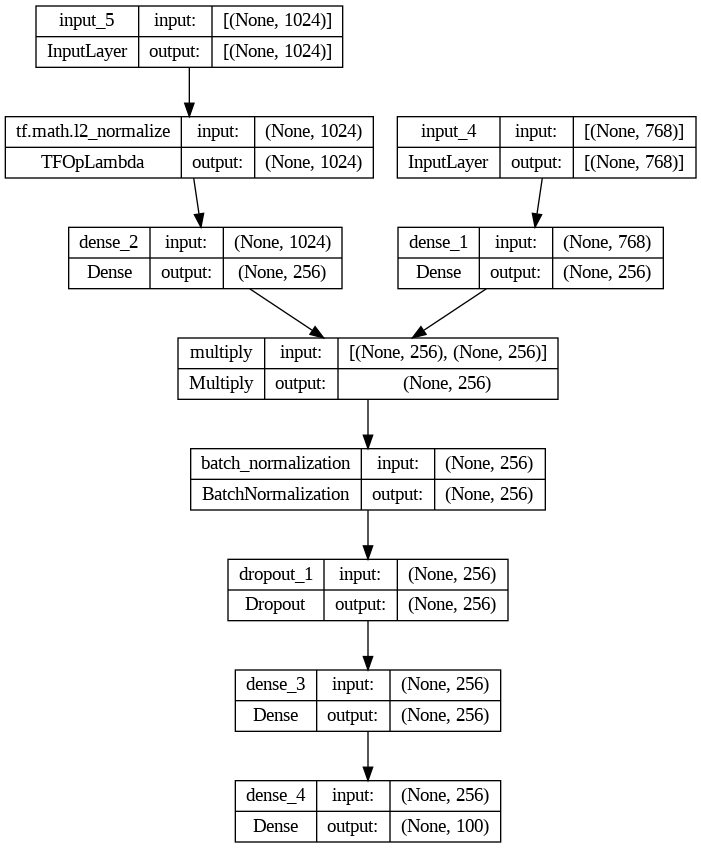

In [ ]:
plot_model(model_4, show_shapes=True)

In [ ]:

loss, accuracy = model_4.evaluate(val_dataloader, verbose=0)
print("Val Loss model_4: {}".format(loss))
print("Val Accuracy model_4: {}".format(accuracy))
%tensorboard --logdir $logdir

KeyboardInterrupt: ignored

In [ ]:
%tensorboard --logdir $logdir

<IPython.core.display.Javascript object>

#Model 5 : Custom DenseNet for Image Embeddings

In [ ]:
from tensorflow.keras import models, layers
compression = 0.5
# Dense Block
def denseblock(input, num_filter = 2, dropout_rate = 0.2):
    global compression
    temp = input
    for _ in range(l):
        BatchNorm = layers.BatchNormalization()(temp)
        relu = layers.Activation('relu')(BatchNorm)
        Conv2D_3_3 = layers.Conv2D(int(num_filter*compression), (3,3), use_bias=False ,padding='same')(relu)
        if dropout_rate>0:
            Conv2D_3_3 = layers.Dropout(dropout_rate)(Conv2D_3_3)
        concat = layers.Concatenate(axis=-1)([temp,Conv2D_3_3])

        temp = concat

    return temp

## transition Blosck
def transition(input, num_filter = 2, dropout_rate = 0.2):
    global compression
    BatchNorm = layers.BatchNormalization()(input)
    relu = layers.Activation('relu')(BatchNorm)
    Conv2D_BottleNeck = layers.Conv2D(int(num_filter*compression), (1,1), use_bias=False ,padding='same')(relu)
    if dropout_rate>0:
         Conv2D_BottleNeck = layers.Dropout(dropout_rate)(Conv2D_BottleNeck)
    avg = layers.AveragePooling2D(pool_size=(2,2))(Conv2D_BottleNeck)
    return avg

#output layer
def output_layer(input):
    global compression
    BatchNorm = layers.BatchNormalization()(input)
    relu = layers.Activation('relu')(BatchNorm)
    AvgPooling = layers.AveragePooling2D(pool_size=(2,2))(relu)
    flat = layers.Flatten()(AvgPooling)
    output = layers.Dense(1048, activation='relu')(flat)
    return output

In [ ]:
num_filter = 6
dropout_rate = 0.4
l = 12

input = layers.Input(shape=(224, 224, 3))
First_Conv2D = layers.Conv2D(21, (3,3), use_bias=False ,padding='same')(input)

First_Block = denseblock(First_Conv2D, 4, dropout_rate)
First_Transition = transition(First_Block, num_filter, dropout_rate)

# Second_Block = denseblock(First_Transition, 6, dropout_rate)
# Second_Transition = transition(Second_Block, 6, dropout_rate)

# Third_Block = denseblock(Second_Transition, 10, dropout_rate)
# Third_Transition = transition(Third_Block,12, dropout_rate)

Last_Block = denseblock(First_Transition,  8, dropout_rate)
out = output_layer(Last_Block)

dnet_featurizer = Model(inputs=input, outputs=out)

dnet_featurizer.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv2d (Conv2D)             (None, 224, 224, 21)         567       ['input_6[0][0]']             
                                                                                                  
 batch_normalization_1 (Bat  (None, 224, 224, 21)         84        ['conv2d[0][0]']              
 chNormalization)                                                                                 
                                                                                                  
 activation (Activation)     (None, 224, 224, 21)         0         ['batch_normalization_1[

In [ ]:
class Data_model_5:
    def __init__(self, data, img_target_size, tknizer,TokenizeReview,bert_featurizer, dnet_featurizer, ohe):
        self.length, self.img_target_size = len(data), img_target_size
        self.questions, self.images = data['question'].values, data['image_path'].values
        self.tknizer = tknizer
        self.tokenizetext = TokenizeReview
        self.bert_featurizer, self.dnet_featurizer = bert_featurizer,dnet_featurizer
        self.answers = data['multiple_choice_answer'].values
        self.ohe = ohe

    def __getitem__(self, i):
        text = clean_questions(self.questions[i])
        tokens, mask, segment = self.tokenizetext(text,self.tknizer)

        pool_out = self.bert_featurizer([tokens,mask,segment])[0]
        img = image.load_img(self.images[i], target_size=self.img_target_size)
        img_arr = image.img_to_array(img)
        #img_arr = preprocess_input(img_arr)
        effnet_feats = self.dnet_featurizer(np.expand_dims(img_arr, axis=0))[0]

        # one-hot encode answer
        ohe_answer = self.ohe.transform(np.asarray([[self.answers[i]]]))[0]

        return pool_out, effnet_feats, ohe_answer

    def __len__(self):
        return self.length

In [ ]:
train_dataset = Data_model_5(train_data, IMG_TARGET_SIZE, tokenizer,TokenizeReview,bert_model ,dnet_featurizer, ohe)
val_dataset  = Data_model_5(val_data,IMG_TARGET_SIZE, tokenizer,TokenizeReview, bert_model,dnet_featurizer, ohe)

BATCH_SIZE = 256
#creating data loaders
train_dataloader = DataLoader(train_dataset,batch_size=BATCH_SIZE,shuffle_every_epoch=True)
val_dataloader = DataLoader(val_dataset,batch_size=BATCH_SIZE, shuffle_every_epoch=True)

In [ ]:
feats, ans = train_dataloader[0]
ques_feats, img_feats = feats
print("Batch shape of image features: ", img_feats.shape)
print("Batch shape of question features: ", ques_feats.shape)
print("Batch shape of one-hot encoded answers: ", ans.shape)

In [ ]:

earlystop = EarlyStopping(monitor = "val_accuracy", patience = 5, verbose = 1)
reduce_lrate = ReduceLROnPlateau(monitor='val_accuracy', factor=0.9, patience=1, min_lr=0.0001)
lrateschedule = LearningRateScheduler(lrate_scheduler, verbose=0)
logdir = os.path.join("model_5",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir = logdir, histogram_freq = 1, write_graph = True)

callback_list_5= [earlystop, reduce_lrate,lrateschedule,tensorboard_callback]

In [ ]:
ques_input = Input(shape=(768, ))
print(ques_input.get_shape())

ques_features = Dense(128, activation='relu', kernel_initializer=tf.keras.initializers.he_normal())(ques_input)
print(ques_features.get_shape())

# Image Features
img_input = Input(shape=(1048,))
print(img_input.get_shape())

l2_normed_effnet_features = tf.math.l2_normalize(img_input, axis=1, epsilon=1e-10)
print(l2_normed_effnet_features.get_shape())

img_features = Dense(128, activation='relu',kernel_initializer=tf.keras.initializers.he_normal(),)(l2_normed_effnet_features)
print(img_features.get_shape())

# img_features = Dense(256, activation='relu', kernel_initializer=tf.keras.initializers.he_normal(),)(img_dense_1)
# print(img_features.get_shape())


# Merge Image and Question embeddings using pointwise multiplication
joint_feat_rep = Multiply()([ques_features, img_features])
print(joint_feat_rep.get_shape())


# Generate Answers
batch_norm_1 = BatchNormalization()(joint_feat_rep)
drop_out_1 = Dropout(0.1)(batch_norm_1)
d1 = Dense(128, activation='relu', kernel_initializer=tf.keras.initializers.he_normal)(drop_out_1)

final_output = Dense(100, activation='softmax', kernel_initializer=tf.keras.initializers.glorot_uniform(seed=3))(d1)
print(final_output.get_shape())

model_5 = Model(inputs=[ques_input, img_input], outputs=final_output)
print(model_5.summary())

model_5.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

model_5.fit(train_dataloader, steps_per_epoch=20, epochs=10,validation_data=val_dataloader, validation_steps=10,
    callbacks=callback_list_5)


(None, 768)
(None, 128)
(None, 1048)
(None, 1048)
(None, 128)
(None, 128)
(None, 100)
Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_10 (InputLayer)       [(None, 1048)]               0         []                            
                                                                                                  
 input_9 (InputLayer)        [(None, 768)]                0         []                            
                                                                                                  
 tf.math.l2_normalize_2 (TF  (None, 1048)                 0         ['input_10[0][0]']            
 OpLambda)                                                                                        
                                                                                                  
 dense

KeyboardInterrupt: ignored

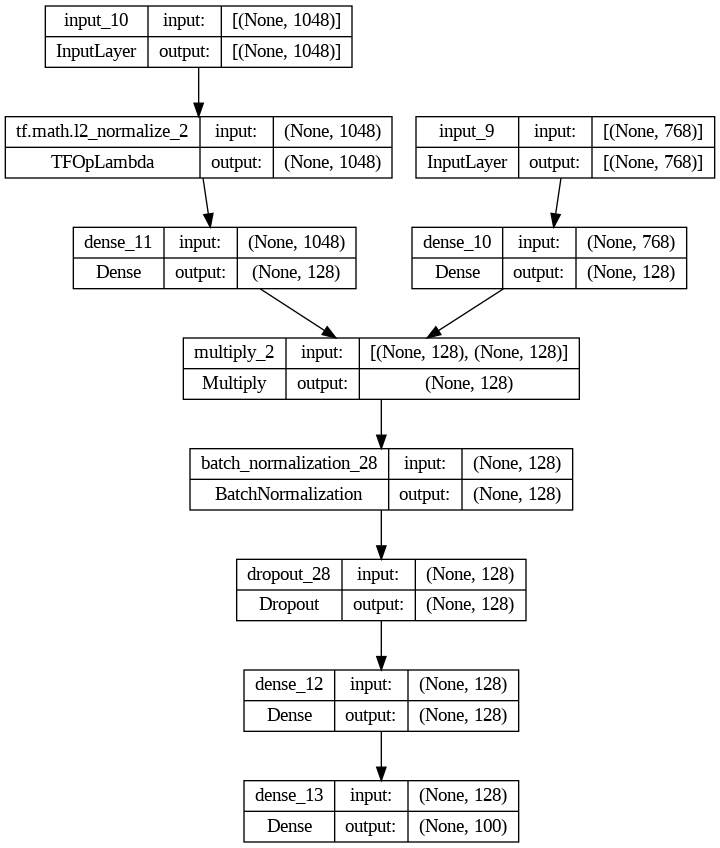

In [ ]:
plot_model(model_5, show_shapes=True)

In [ ]:

loss, accuracy = model_5.evaluate(val_dataloader, verbose=0)
print("Val Loss model_4: {}".format(loss))
print("Val Accuracy model_4: {}".format(accuracy))


In [ ]:
%tensorboard --logdir $logdir

<IPython.core.display.Javascript object>